titulo

In [2]:
#basic libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import os
os.chdir('D:/projects/earthquakes')
import geopandas as gpd
import folium

In [3]:
def embed_map(m, file_name):
    from IPython.display import IFrame
    m.save(file_name)
    return IFrame(file_name, width='100%', height='500px')

In [4]:
pob = pd.read_csv('D:/projects/earthquakes/data/pob.csv')

In [5]:
pob.head()

,ubigeo_reniec,ubigeo_inei,Departamento,Provincia,Distrito,Edad_Anio,Sexo,Cantidad
0,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,6,M,9
1,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,65-69,F,23
2,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,65-69,M,25
3,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,60-64,F,40
4,21406,21910,ANCASH,SIHUAS,SICSIBAMBA,60-64,M,30


In [6]:
pob.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 123684 entries, 0 to 123683
Data columns (total 8 columns):
 #   Column         Non-Null Count   Dtype 
---  ------         --------------   ----- 
 0   ubigeo_reniec  123684 non-null  int64 
 1   ubigeo_inei    123684 non-null  int64 
 2   Departamento   123684 non-null  object
 3   Provincia      123684 non-null  object
 4   Distrito       123684 non-null  object
 5   Edad_Anio      123684 non-null  object
 6   Sexo           123684 non-null  object
 7   Cantidad       123684 non-null  int64 
dtypes: int64(3), object(5)
memory usage: 7.5+ MB


In [8]:
df = pob.groupby(['Departamento','Provincia','Distrito','ubigeo_inei'])['Cantidad'].sum().reset_index()


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1874 entries, 0 to 1873
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Departamento  1874 non-null   object
 1   Provincia     1874 non-null   object
 2   Distrito      1874 non-null   object
 3   ubigeo_inei   1874 non-null   int64 
 4   Cantidad      1874 non-null   int64 
dtypes: int64(2), object(3)
memory usage: 73.3+ KB


In [10]:
#agregamos un cero y lo limitamos para que se una con el otro ubigeo
df['UBIGEO']= df.ubigeo_inei.apply(lambda x : str(x).zfill(6))

In [11]:
df = df[['UBIGEO','Cantidad']]
df['UBIGEO'] = df['UBIGEO'].astype(str).astype(int)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1874 entries, 0 to 1873
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   UBIGEO    1874 non-null   int32
 1   Cantidad  1874 non-null   int64
dtypes: int32(1), int64(1)
memory usage: 22.1 KB


In [13]:
prov = gpd.read_file('D:/projects/earthquakes/data/sh/LIMITE_PROVINCIA/LIMITE_PROV.shp')
dist = gpd.read_file('D:/projects/earthquakes/data/sh/LIMITE_DISTRITO/LIMITE_DIST.shp')
dep = gpd.read_file('D:/projects/earthquakes/data/sh/LIMITE_DEPARTAMENTO/LIMITE_DEP.shp')


In [14]:
pob.groupby(['Departamento'])['Cantidad'].sum()

Departamento
AMAZONAS           427041
ANCASH            1171756
APURIMAC           466936
AREQUIPA          1350676
AYACUCHO           718634
CAJAMARCA         1543104
CALLAO            1067815
CUSCO             1346373
HUANCAVELICA       509117
HUANUCO            889134
ICA                817965
JUNIN             1389850
LA LIBERTAD       1956389
LAMBAYEQUE        1300720
LIMA             10458367
LORETO            1077831
MADRE DE DIOS      150181
MOQUEGUA           187941
PASCO              312777
PIURA             1901896
PUNO              1471405
SAN MARTIN         884795
TACNA              358314
TUMBES             248877
UCAYALI            518190
Name: Cantidad, dtype: int64

In [15]:
dep

,OBJECTID,CCDD,NOMBDEP,Shape_Leng,Shape_Area,geometry
0,1,01,AMAZONAS,12.912088,3.203006,"POLYGON ((-77.81399 -2.99278, -77.81483 -2.995..."
1,2,02,ANCASH,11.771520,2.954605,"POLYGON ((-77.64697 -8.05086, -77.64689 -8.051..."
2,3,03,APURIMAC,7.730154,1.765933,"POLYGON ((-73.74655 -13.17442, -73.74570 -13.1..."
3,4,04,AREQUIPA,17.429625,5.330203,"POLYGON ((-71.98109 -14.64062, -71.98093 -14.6..."
4,5,05,AYACUCHO,17.127166,3.643705,"POLYGON ((-74.34843 -12.17503, -74.35000 -12.1..."
5,6,06,CAJAMARCA,12.399239,2.684527,"POLYGON ((-78.70034 -4.62769, -78.69817 -4.629..."
6,7,07,CALLAO,1.131635,0.011740,"POLYGON ((-77.13504 -11.81820, -77.13484 -11.8..."
7,8,08,CUSCO,21.794434,6.000331,"POLYGON ((-72.97280 -11.25189, -72.97134 -11.2..."
8,9,09,HUANCAVELICA,9.561245,1.839851,"POLYGON ((-74.57118 -11.98710, -74.57095 -11.9..."
9,10,10,HUANUCO,14.589840,3.089811,"POLYGON ((-75.99200 -8.32108, -75.99015 -8.321..."


In [8]:
pd.Series(dep.geometry.to_crs(epsg=32654).area / 10**6, name="area_km2").to_frame()

,area_km2
0,65011.739496
1,58071.745972
2,29946.129330
3,88122.718779
4,63286.612319
5,55271.743349
6,223.334678
7,100672.072477
8,32925.775708
9,58175.493949


de la base de pob el ubigeo_inei es la llave con la base dist UBIGEO pero esta tiene un 0 de mas

In [9]:
dist

,OBJECTID_1,CCDD,NOMBDEP,CCPP,NOMBPROV,CCDI,NOMBDIST,UBIGEO,IDPROV,Shape_STAr,Shape_STLe,Shape_Leng,Shape_Area,geometry
0,1,15,LIMA,01,LIMA,38,SANTA MARIA DEL MAR,150138,1501,0.000649,0.156101,0.156101,0.000649,"MULTIPOLYGON (((-76.78182 -12.40919, -76.78173..."
1,2,15,LIMA,05,CAÑETE,05,CHILCA,150505,1505,0.040063,1.154549,1.154549,0.040063,"POLYGON ((-76.55171 -12.28024, -76.55021 -12.2..."
2,3,15,LIMA,01,LIMA,19,LURIN,150119,1501,0.015603,0.825145,0.820880,0.015595,"MULTIPOLYGON (((-76.70549 -12.17672, -76.70429..."
3,4,15,LIMA,01,LIMA,24,PUCUSANA,150124,1501,0.002562,0.437869,0.437869,0.002562,"MULTIPOLYGON (((-76.77367 -12.42553, -76.77332..."
4,5,15,LIMA,01,LIMA,26,PUNTA HERMOSA,150126,1501,0.010145,0.607714,0.607714,0.010145,"MULTIPOLYGON (((-76.65645 -12.18799, -76.65559..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1869,1870,20,PIURA,07,TALARA,01,PARIÑAS,200701,2007,0.091179,1.664519,1.664519,0.091179,"POLYGON ((-80.89458 -4.31752, -80.89412 -4.318..."
1870,1871,20,PIURA,06,SULLANA,02,BELLAVISTA,200602,2006,0.000189,0.061508,0.061508,0.000189,"POLYGON ((-80.66936 -4.88347, -80.66932 -4.883..."
1871,1872,20,PIURA,01,PIURA,15,VEINTISEIS DE OCTUBRE,200115,2001,0.005833,0.419652,0.419652,0.005833,"POLYGON ((-80.66118 -5.14968, -80.66102 -5.150..."
1872,1873,10,HUANUCO,06,LEONCIO PRADO,08,CASTILLO GRANDE,100608,1006,0.008583,0.533859,0.533859,0.008583,"POLYGON ((-76.08083 -9.13017, -76.08026 -9.130..."


In [10]:
dist = dist[['NOMBDEP','NOMBPROV','NOMBDIST','UBIGEO','geometry']]

In [11]:
dist.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1874 entries, 0 to 1873
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   NOMBDEP   1874 non-null   object  
 1   NOMBPROV  1874 non-null   object  
 2   NOMBDIST  1874 non-null   object  
 3   UBIGEO    1874 non-null   object  
 4   geometry  1874 non-null   geometry
dtypes: geometry(1), object(4)
memory usage: 73.3+ KB


In [12]:
dist['UBIGEO'] = dist['UBIGEO'].astype(str).astype(int)


In [20]:
data = pd.merge(dist, df, how= 'left',on = 'UBIGEO')
data.to_csv('base.csv')

In [21]:
data.sort_values(by='Cantidad', ascending=False)
#el distrito mas poblado es san juan de lurigancho

,NOMBDEP,NOMBPROV,NOMBDIST,UBIGEO,geometry,Cantidad
915,LIMA,LIMA,SAN JUAN DE LURIGANCHO,150132,"MULTIPOLYGON (((-77.03065 -11.99639, -77.03056...",1160109
896,LIMA,LIMA,SAN MARTIN DE PORRES,150135,"POLYGON ((-77.08499 -11.93760, -77.08485 -11.9...",744333
888,LIMA,LIMA,ATE,150103,"POLYGON ((-76.83689 -11.99370, -76.83517 -11.9...",669808
897,LIMA,LIMA,COMAS,150110,"POLYGON ((-77.04643 -11.89743, -77.04560 -11.8...",557997
894,LIMA,LIMA,VILLA EL SALVADOR,150142,"POLYGON ((-76.93980 -12.18648, -76.93945 -12.1...",492201
...,...,...,...,...,...,...
1420,AMAZONAS,CHACHAPOYAS,SONCHE,10121,"POLYGON ((-77.86135 -6.11924, -77.86133 -6.119...",221
1439,AMAZONAS,BONGARA,RECTA,10308,"POLYGON ((-77.79211 -5.89905, -77.79180 -5.899...",207
867,LIMA,YAUYOS,HUAMPARA,151013,"POLYGON ((-76.22344 -12.29909, -76.22260 -12.2...",200
272,TACNA,CANDARAVE,CURIBAYA,230204,"POLYGON ((-70.29981 -17.33536, -70.29947 -17.3...",187


- Vamos a leer un excel con coordenadas, queremos cambiar los puntos a formato geolocalizable

In [31]:
sismos = pd.read_excel('D:/projects/earthquakes/data/sismoshist.xlsx')
sismos = gpd.GeoDataFrame(sismos, geometry=gpd.points_from_xy(sismos.LONGITUD, sismos.LATITUD))

In [35]:

print("En el Peru hubo {} sismos" .format(sismos.shape[0]))
sismos #solo los sismos de 2021

En el Peru hubo 22712 sismos


,ID,FECHA_UTC,HORA_UTC,LATITUD,LONGITUD,PROFUNDIDAD,MAGNITUD,FECHA_CORTE,geometry
0,0,19600113,154034,-16.1450,-72.1440,60,7.5,20223006,POINT (-72.14400 -16.14500)
1,1,19600115,93024,-15.0000,-75.0000,70,7.0,20223006,POINT (-75.00000 -15.00000)
2,2,19600117,25758,-14.5000,-74.5000,150,6.4,20223006,POINT (-74.50000 -14.50000)
3,3,19600123,33732,-12.5000,-68.5000,300,5.8,20223006,POINT (-68.50000 -12.50000)
4,4,19600130,50724,-5.5000,-77.5000,100,5.7,20223006,POINT (-77.50000 -5.50000)
...,...,...,...,...,...,...,...,...,...
22707,22707,20211231,150417,-12.6706,-76.9744,33,3.7,20223006,POINT (-76.97440 -12.67060)
22708,22708,20211231,153529,-8.0493,-74.4580,140,4.6,20223006,POINT (-74.45800 -8.04930)
22709,22709,20211231,165608,-14.9097,-75.3355,42,3.9,20223006,POINT (-75.33550 -14.90970)
22710,22710,20211231,171759,-5.5762,-76.3891,127,4.5,20223006,POINT (-76.38910 -5.57620)


<AxesSubplot:>

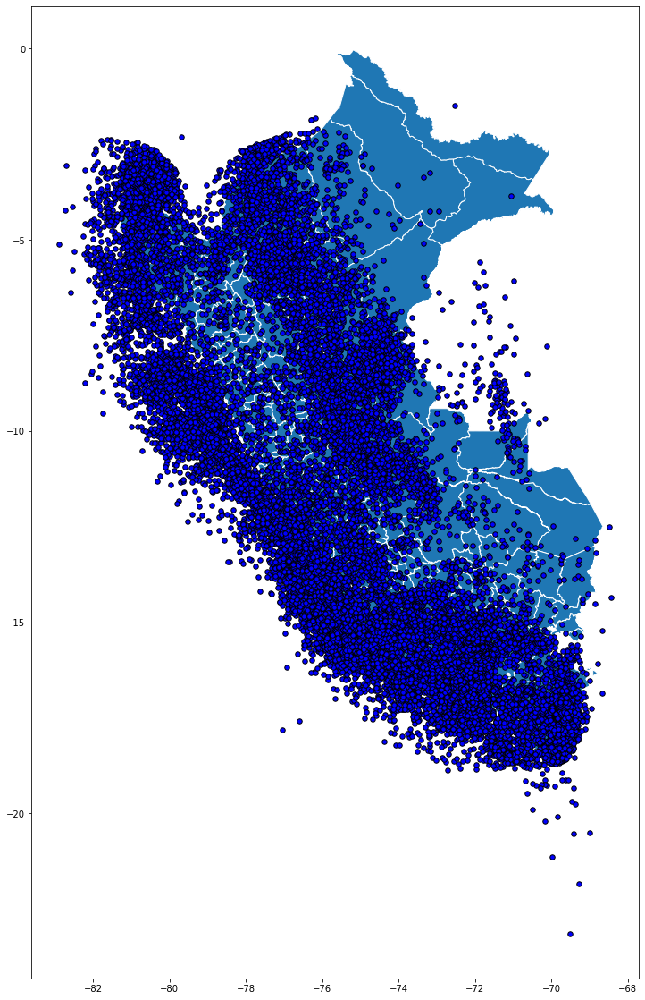

In [36]:
base = prov.plot( 
          figsize=(20, 20),
          linestyle='-',
          edgecolor='white',
          legend = True )

sismos.plot(ax = base, color = 'blue', markersize=30, edgecolor='black')


In [111]:
dep

,OBJECTID,CCDD,NOMBDEP,Shape_Leng,Shape_Area,geometry
0,1,01,AMAZONAS,12.912088,3.203006,"POLYGON ((-77.81399 -2.99278, -77.81483 -2.995..."
1,2,02,ANCASH,11.771520,2.954605,"POLYGON ((-77.64697 -8.05086, -77.64689 -8.051..."
2,3,03,APURIMAC,7.730154,1.765933,"POLYGON ((-73.74655 -13.17442, -73.74570 -13.1..."
3,4,04,AREQUIPA,17.429625,5.330203,"POLYGON ((-71.98109 -14.64062, -71.98093 -14.6..."
4,5,05,AYACUCHO,17.127166,3.643705,"POLYGON ((-74.34843 -12.17503, -74.35000 -12.1..."
5,6,06,CAJAMARCA,12.399239,2.684527,"POLYGON ((-78.70034 -4.62769, -78.69817 -4.629..."
6,7,07,CALLAO,1.131635,0.011740,"POLYGON ((-77.13504 -11.81820, -77.13484 -11.8..."
7,8,08,CUSCO,21.794434,6.000331,"POLYGON ((-72.97280 -11.25189, -72.97134 -11.2..."
8,9,09,HUANCAVELICA,9.561245,1.839851,"POLYGON ((-74.57118 -11.98710, -74.57095 -11.9..."
9,10,10,HUANUCO,14.589840,3.089811,"POLYGON ((-75.99200 -8.32108, -75.99015 -8.321..."


In [ ]:
superficie = 

In [114]:
m_2 = folium.Map(location=[35,136], tiles='cartodbpositron', zoom_start=5)

for _, r in dep.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'none'})
    folium.Popup(r['NOMBDEP']).add_to(geo_j)
    geo_j.add_to(m_2)



m_2

In [117]:
sismos.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 834 entries, 0 to 833
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Fecha       834 non-null    object  
 1   Hora_UTC    834 non-null    object  
 2   Y           834 non-null    float64 
 3   X           834 non-null    float64 
 4   Profundida  834 non-null    float64 
 5   Magnitud    834 non-null    float64 
 6   geometry    834 non-null    geometry
dtypes: float64(4), geometry(1), object(2)
memory usage: 45.7+ KB


In [140]:
inter.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 6336 entries, 0 to 6335
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Magnitud    6336 non-null   float64 
 1   Fuente      5026 non-null   object  
 2   LOCALIDAD   10 non-null     object  
 3   mb__ML__Ms  6336 non-null   float64 
 4   Intensidad  122 non-null    object  
 5   Prof_       6336 non-null   float64 
 6   PAIS        979 non-null    object  
 7   Rango       3716 non-null   object  
 8   Latitud     6336 non-null   float64 
 9   Longitud    6336 non-null   float64 
 10  geometry    6336 non-null   geometry
dtypes: float64(5), geometry(1), object(5)
memory usage: 544.6+ KB


In [139]:
inter['Latitud'] = inter['Latitud'].astype(str).astype(flointat)
inter['Longitud'] = inter['Longitud'].astype(str).astype(float)

In [40]:
sismos

,ID,FECHA_UTC,HORA_UTC,LATITUD,LONGITUD,PROFUNDIDAD,MAGNITUD,FECHA_CORTE,geometry
0,0,19600113,154034,-16.1450,-72.1440,60,7.5,20223006,POINT (-72.14400 -16.14500)
1,1,19600115,93024,-15.0000,-75.0000,70,7.0,20223006,POINT (-75.00000 -15.00000)
2,2,19600117,25758,-14.5000,-74.5000,150,6.4,20223006,POINT (-74.50000 -14.50000)
3,3,19600123,33732,-12.5000,-68.5000,300,5.8,20223006,POINT (-68.50000 -12.50000)
4,4,19600130,50724,-5.5000,-77.5000,100,5.7,20223006,POINT (-77.50000 -5.50000)
...,...,...,...,...,...,...,...,...,...
22707,22707,20211231,150417,-12.6706,-76.9744,33,3.7,20223006,POINT (-76.97440 -12.67060)
22708,22708,20211231,153529,-8.0493,-74.4580,140,4.6,20223006,POINT (-74.45800 -8.04930)
22709,22709,20211231,165608,-14.9097,-75.3355,42,3.9,20223006,POINT (-75.33550 -14.90970)
22710,22710,20211231,171759,-5.5762,-76.3891,127,4.5,20223006,POINT (-76.38910 -5.57620)


In [46]:
m_2 = folium.Map(location=[-11.488508, -76.614951], tiles='cartodbpositron', zoom_start=5)

# Your code here: Add a map to visualize earthquake depth


def color_producer(magnitude):
    if magnitude > 5.5:
        return 'red'
    else:
        return 'green'
    
for i in range(0,len(sismos)):
    folium.Circle(
    location=[sismos.iloc[i]['LATITUD'], sismos.iloc[i]['LONGITUD']], radius = 2000, color = color_producer(sismos.iloc[i]['MAGNITUD'])).add_to(m_2)


for i in range(0,len(sismos)):
    folium.Circle(
        location=[sismos.iloc[i]['LATITUD'], sismos.iloc[i]['LONGITUD']],
        radius=sismos.iloc[i]['MAGNITUD']**5.5,
        color=color_producer(sismos.iloc[i]['MAGNITUD'])).add_to(m_2)
# View the map
for _, r in dep.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'none'})
    folium.Popup(r['NOMBDEP']).add_to(geo_j)
    geo_j.add_to(m_2)

m_2

embed_map(m_2, 'q_1.html')


In [70]:
superf = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_superficiales_1960_2018.shp')
inter = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_intermedios_1960_2018.shp')
prof = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_profundos_1960_2018.shp')


In [76]:
sis_2017 = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_2017.shp')
sis_2018 = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_2018.shp')
sis_2019 = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_2019.shp')
sis_2020 = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_2020.shp')
sis_2021 = gpd.read_file('D:/projects/earthquakes/data/Shp/Sismos_2021.shp')

In [78]:
sis_2018

,Fecha,Hora_GMT,Latitud,Longitud,Prof,mb__ML__Ms,Intensidad,geometry
0,2018-01-01,1899-12-30,-14.9225,-73.6197,142.0,4.1,None,POINT (-73.61970 -14.92250)
1,2018-01-01,1899-12-30,-15.6269,-70.7813,189.0,4.0,None,POINT (-70.78130 -15.62690)
2,2018-01-02,1899-12-30,-11.9831,-77.7237,27.0,3.8,"II Lima, Callao",POINT (-77.72370 -11.98310)
3,2018-01-02,1899-12-30,-10.6559,-74.2408,107.0,4.0,None,POINT (-74.24080 -10.65590)
4,2018-01-02,1899-12-30,-8.5175,-80.0582,43.0,4.1,None,POINT (-80.05820 -8.51750)
...,...,...,...,...,...,...,...,...
780,2018-12-29,1899-12-30,-14.6939,-75.2592,46.0,4.0,None,POINT (-75.25920 -14.69390)
781,2018-12-29,1899-12-30,-15.4268,-72.1927,129.0,4.0,None,POINT (-72.19270 -15.42680)
782,2018-12-30,1899-12-30,-15.6336,-71.8638,12.0,3.6,"II-III Pinchollo, Maca",POINT (-71.86380 -15.63360)
783,2018-12-30,1899-12-30,-10.4286,-78.9446,29.0,4.4,"II-III Huarmey; II Casma, Barranca",POINT (-78.94460 -10.42860)


In [77]:
sis_2017

,X,Y,Profundida,Magnitud,Intensidad,F6,F7,Hora,F10,Fecha_1,geometry
0,-76.8416,-12.9721,45.0,4.4,"III Mala, Chilca; II Lima",None,None,02:45:36,2017_00,2017-01-01,POINT (-76.84160 -12.97210)
1,-76.4678,-4.9249,118.0,5.8,"III-IV Yurimaguas, Moyobamba; III Chachapoyas,...",None,None,13:13:47,2017_01,None,POINT (-76.46780 -4.92490)
2,-70.6282,-19.5521,7.0,5.2,"III Tacna, II Ilo, II Arequipa",None,None,13:41:54,2017_02,2017-01-03,POINT (-70.62820 -19.55210)
3,-76.4272,-13.4277,58.0,4.2,"II-III Chincha, Pisco, Ca?te",None,None,08:28:38,2017_03,2017-01-04,POINT (-76.42720 -13.42770)
4,-71.8568,-15.7061,15.0,3.7,"III Pinchollo; II Huambo, Maca",None,None,11:44:17,2017_04,2017-01-05,POINT (-71.85680 -15.70610)
...,...,...,...,...,...,...,...,...,...,...,...
350,-77.8182,-11.3628,61.0,4.1,"II Huacho, Lima",None,None,02:17:11,2017_350,None,POINT (-77.81820 -11.36280)
351,-69.5905,-17.6806,160.0,4.8,II-III Tacna,None,None,15:26:11,2017_351,None,POINT (-69.59050 -17.68060)
352,-79.6627,-5.7972,108.0,4.8,III Lambayeque; II Chiclayo,None,None,18:47:32,2017_352,None,POINT (-79.66270 -5.79720)
353,-74.4601,-13.0981,73.0,4.7,III Ayacucho,None,None,07:14:48,2017_353,None,POINT (-74.46010 -13.09810)


In [75]:
prof

,mb__ML__Ms,Intensidad,Prof_,Mag,Rango,Fuente,Latitud,Longitud,geometry
0,4.7,None,347.0,0.0,None,None,-21.2949,-68.6153,POINT (-68.61530 -21.29490)
1,4.8,None,608.0,0.0,None,None,-8.7246,-71.3994,POINT (-71.39940 -8.72460)
2,4.7,None,369.0,0.0,None,None,-21.4425,-67.7362,POINT (-67.73620 -21.44250)
3,4.4,None,303.0,0.0,None,None,-19.3761,-68,POINT (-68.00000 -19.37610)
4,4.0,None,351.0,0.0,None,None,-19.7581,-67.6784,POINT (-67.67840 -19.75810)
...,...,...,...,...,...,...,...,...,...
108,0.0,None,0.0,0.0,7-7.9,IGP,-1.486,-72.556,POINT (-72.55600 -1.48600)
109,0.0,None,0.0,0.0,7-7.9,IGP,-8.313,-71.402,POINT (-71.40200 -8.31300)
110,0.0,None,0.0,0.0,7-7.9,IGP,-11.032,-70.741,POINT (-70.74100 -11.03200)
111,0.0,None,0.0,0.0,7-7.9,IGP,-13.408,-69.4,POINT (-69.40000 -13.40800)


- CAPDEP99: marca las capitales de los departamentos

In [65]:
circulos

,fecha,lati,long,prof,mag,geometry
0,2014-07-22T00:53:02.260Z,-6.1185,-72.0276,565.23,4.2,POINT (-72.02760 -6.11850)
1,2014-04-07T15:27:32.600Z,-8.2424,-71.5809,560.89,5.1,POINT (-71.58090 -8.24240)
2,2013-10-29T09:50:45.110Z,-9.2992,-71.1485,635.83,4.5,POINT (-71.14850 -9.29920)


<AxesSubplot:>

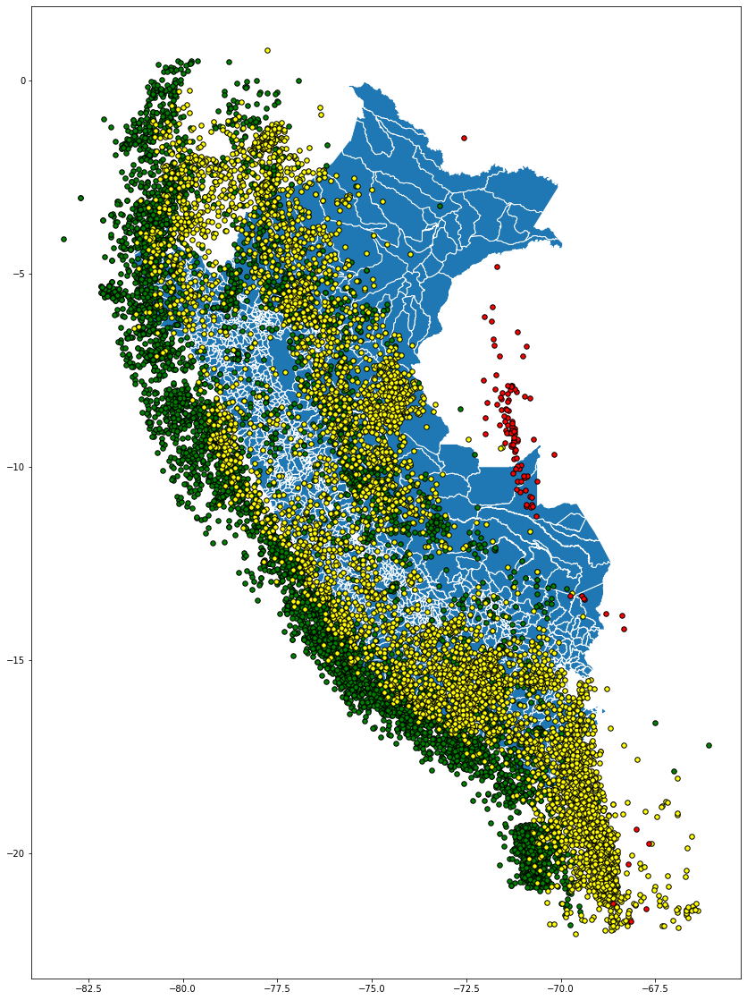

In [71]:
base = data.plot( 
          figsize=(20, 20),
          linestyle='-',
          edgecolor='white',
          legend = True )

#sismos.plot(ax = base, color = 'red', markersize=30, edgecolor='black')
superf.plot(ax = base, color = 'green', markersize=30, edgecolor='black')
inter.plot(ax = base, color = 'yellow', markersize=30, edgecolor='black')

prof.plot(ax = base, color = 'red', markersize=30, edgecolor='black')




---

densidad poblacional

In [158]:
formas = dep[['NOMBDEP','geometry']].set_index('NOMBDEP')

In [159]:
formas

,geometry
NOMBDEP,
AMAZONAS,"POLYGON ((-77.81399 -2.99278, -77.81483 -2.995..."
ANCASH,"POLYGON ((-77.64697 -8.05086, -77.64689 -8.051..."
APURIMAC,"POLYGON ((-73.74655 -13.17442, -73.74570 -13.1..."
AREQUIPA,"POLYGON ((-71.98109 -14.64062, -71.98093 -14.6..."
AYACUCHO,"POLYGON ((-74.34843 -12.17503, -74.35000 -12.1..."
CAJAMARCA,"POLYGON ((-78.70034 -4.62769, -78.69817 -4.629..."
CALLAO,"POLYGON ((-77.13504 -11.81820, -77.13484 -11.8..."
CUSCO,"POLYGON ((-72.97280 -11.25189, -72.97134 -11.2..."
HUANCAVELICA,"POLYGON ((-74.57118 -11.98710, -74.57095 -11.9..."


In [160]:
superficie = pd.read_excel('D:/projects/earthquakes/data/superficie.xlsx')
superficie.set_index('Departamento', inplace=True)

In [161]:
superficie

,Ubigeo,Capital,Superficie
Departamento,,,
AMAZONAS,1,Chachapoyas,39249
ANCASH,2,Huaraz,35915
APURIMAC,3,Abancay,20896
AREQUIPA,4,Arequipa,63345
AYACUCHO,5,Ayacucho,43815
CAJAMARCA,6,Cajamarca,33318
CALLAO,7,Callao,147
CUSCO,8,Cuzco,71987
HUANCAVELICA,9,Huancavelica,22131


In [162]:
pob.groupby('Departamento')['Cantidad'].sum()

Departamento
AMAZONAS           427041
ANCASH            1171756
APURIMAC           466936
AREQUIPA          1350676
AYACUCHO           718634
CAJAMARCA         1543104
CALLAO            1067815
CUSCO             1346373
HUANCAVELICA       509117
HUANUCO            889134
ICA                817965
JUNIN             1389850
LA LIBERTAD       1956389
LAMBAYEQUE        1300720
LIMA             10458367
LORETO            1077831
MADRE DE DIOS      150181
MOQUEGUA           187941
PASCO              312777
PIURA             1901896
PUNO              1471405
SAN MARTIN         884795
TACNA              358314
TUMBES             248877
UCAYALI            518190
Name: Cantidad, dtype: int64

In [164]:
datos = superficie.join(formas).join(pob.groupby('Departamento')['Cantidad'].sum())

In [169]:
#creamos la densidad poblacional
datos['Densidad'] = datos['Cantidad'] / datos['Superficie']

In [170]:
datos

,Ubigeo,Capital,Superficie,geometry,Cantidad,Densidad
Departamento,,,,,,
AMAZONAS,1,Chachapoyas,39249,"POLYGON ((-77.81399 -2.99278, -77.81483 -2.995...",427041,10.880303
ANCASH,2,Huaraz,35915,"POLYGON ((-77.64697 -8.05086, -77.64689 -8.051...",1171756,32.625811
APURIMAC,3,Abancay,20896,"POLYGON ((-73.74655 -13.17442, -73.74570 -13.1...",466936,22.345712
AREQUIPA,4,Arequipa,63345,"POLYGON ((-71.98109 -14.64062, -71.98093 -14.6...",1350676,21.322535
AYACUCHO,5,Ayacucho,43815,"POLYGON ((-74.34843 -12.17503, -74.35000 -12.1...",718634,16.401552
CAJAMARCA,6,Cajamarca,33318,"POLYGON ((-78.70034 -4.62769, -78.69817 -4.629...",1543104,46.314425
CALLAO,7,Callao,147,"POLYGON ((-77.13504 -11.81820, -77.13484 -11.8...",1067815,7264.047619
CUSCO,8,Cuzco,71987,"POLYGON ((-72.97280 -11.25189, -72.97134 -11.2...",1346373,18.703002
HUANCAVELICA,9,Huancavelica,22131,"POLYGON ((-74.57118 -11.98710, -74.57095 -11.9...",509117,23.004699


In [176]:
# Create a base map
m_3 = folium.Map(location=[35,136], tiles='cartodbpositron', zoom_start=5)

# Your code here: create a choropleth map to visualize population density
folium.Choropleth(
geo_data =formas['geometry'].__geo_interface__,
data = datos['Cantidad'],
key_on = 'feature.id',
fill_color = 'YlGnBu',
legend_name = 'Population density (per square kilometer)').add_to(m_3)



def color_producer(magnitude):
    if magnitude > 5.5:
        return 'red'
    else:
        return 'green'
    
#for i in range(0,len(inter)):
#    folium.Circle(
#    location=[inter.iloc[i]['Y'], inter.iloc[i]['X']], radius = 2000, color = color_depth(inter.iloc[i]['Profundida'])).add_to(m_2)
# Uncomment to see a hint
#q_2.a.hint()

for i in range(0,len(inter)):
    folium.Circle(
        location=[inter.iloc[i]['Latitud'], inter.iloc[i]['Longitud']],
        radius=inter.iloc[i]['Magnitud']**5.5,
        color=color_producer(inter.iloc[i]['Magnitud'])).add_to(m_3)

# Uncomment to see a hint
#q_3.a.hint()

# View the map
m_3

In [179]:
#centros hospitalarios

hosp = pd.read_csv('D:/projects/earthquakes/data/centros_hospitalarios.csv')
Public_health = gpd.GeoDataFrame( hosp, geometry=gpd.points_from_xy( hosp.NORTE, hosp.ESTE ) )




In [206]:
Public_health = Public_health[ ~Public_health['ESTE'].isna()]
Public_health1 = Public_health[Public_health.code1 == "19"]

Public_health2 = Public_health[(Public_health.code1 == "12") | (Public_health.code1 == "24")]

In [215]:


m_3 = folium.Map(location=[35,136], tiles='cartodbpositron', zoom_start=5)

# Your code here: create a choropleth map to visualize population density
folium.Choropleth(
geo_data =formas['geometry'].__geo_interface__,
data = datos['Cantidad'],
key_on = 'feature.id',
fill_color = 'YlGnBu',
legend_name = 'Population density (per square kilometer)').add_to(m_3)



def color_producer(magnitude):
    if magnitude > 5.5:
        return 'red'
    else:
        return 'orange'
    
#for i in range(0,len(inter)):
#    folium.Circle(
#    location=[inter.iloc[i]['Y'], inter.iloc[i]['X']], radius = 2000, color = color_depth(inter.iloc[i]['Profundida'])).add_to(m_2)
# Uncomment to see a hint
#q_2.a.hint()

for i in range(0,len(inter)):
    folium.Circle(
        location=[inter.iloc[i]['Latitud'], inter.iloc[i]['Longitud']],
        radius=inter.iloc[i]['Magnitud']**5.5,
        color=color_producer(inter.iloc[i]['Magnitud'])).add_to(m_3)

# Uncomment to see a hint
#q_3.a.hint()

# View the map




for i in range(0,len(Public_health2)):
    folium.Marker(
      location=[Public_health2.iloc[i]['ESTE'], Public_health2.iloc[i]['NORTE']],
      icon=folium.Icon(color='green',icon='glyphicon glyphicon-plus-sign')
   ).add_to(m_3)


for i in range(0,len(Public_health1)):
    folium.Circle(
    location=[Public_health1.iloc[i]['ESTE'], Public_health1.iloc[i]['NORTE']], radius = 100, color = 'black').add_to(m_3)
# Uncomment to see a hint



   
m_3